# Linear Regression

**Linear Regression** is a **supervised learning algorithm** used to model the relationship between an **input feature** and a **target output** by fitting a straight line. It is used in both statistics and machine learning to predict continuous values.
The **hypothesis function** (prediction formula) is: 
**$$y = w * x + b$$**
- **x**: the input feature (years of experience in our data)  
- **y**: the actual/true output value (salary in our data)  
- **w**: the weight or slope — controls how much influence \(x\) has on the prediction  
- **b**: the bias or intercept — a constant that shifts the line up/down

Linear regression with one variable is also called univariate linear regression. If there are **multiple features** (like experience, education level, etc.), this is multivariable linear regression and the model becomes:

$$y = w_1* x_1 + w_2* x_2 + ... + w_n* x_n + b$$

This is still a linear model — each input feature has a **weight**, and there's one **bias term**.
<br>
The goal is to find the **best values of \(w\) and \(b\)** such that the line \(y = wx + b\) fits the data as closely as possible. A good fit means the **predicted values** $y_i$ are close to the actual values **y**. To evaluate how good a line is, we use the **Mean Squared Error**:
**The Mean Squared Error (MSE)** formula is:

$$MSE = \frac{1}{n} \sum_{i=1}^{n}(Y_i - \hat{Y_i})^2$$

* $n$ represents the number of data points.
* $Y_i$ represents the actual value for the $i$-th data point.
* $\hat{Y_i}$ represents the predicted value for the $i$-th data point.


MSE measures the **average squared difference** between predicted and true values. Lower MSE means better fit.
<br>
We don’t know the best \(w\) and \(b\) — so we **start from zeros (or small random values)** and **update them iteratively** to reduce MSE using **Gradient Descent**.
Gradient Descent updates the weights as:


\begin{align*}
w &\leftarrow w - \alpha \cdot \frac{\partial \text{MSE}}{\partial w} \\
b &\leftarrow b - \alpha \cdot \frac{\partial \text{MSE}}{\partial b}
\end{align*}


- $\alpha$ is the **learning rate**
- $\frac{\partial \text{MSE}}{\partial w}, \frac{\partial \text{MSE}}{\partial b}$ are **gradients** (slopes)

These gradients point in the direction that increases MSE, so subtracting them moves toward **lower error**.


In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import statistics

In [2]:
class Linear_Regression():
    def __init__(self, no_of_iterations=1000, learning_rate=0.01):
        # Initializing hyperparameters
        self.no_of_iterations = no_of_iterations  # Total number of gradient descent steps
        self.learning_rate = learning_rate  # Step size for weight/bias updates

    def fit(self, X, y):
        # Initializing training data and parameters
        self.m, self.n = X.shape # m = number of samples, n = number of features
        self.X = X # Feature matrix
        self.y = y # Target values
        
        # Initializing weights and bias
        self.w = np.zeros(self.n) # Weights (initialized to 0 for each feature)
        self.b = 0 # Bias term

        # Storing training progress
        self.history = []  # To track (w, b) at each iteration
        
        # Performing gradient descent for given number of iterations
        for i in range(self.no_of_iterations):
            self.update_weight() # Updating weights and bias using gradient
            self.history.append((float(self.w), float(self.b))) 

    
    def update_weight(self):
        # Predicting y using current weights and bias
        y_train_pred = self.predict(self.X)

            
        # Computing gradients (partial derivatives of MSE with respect to w and b)
        dw =  -(2/self.m) * (self.X.T).dot(self.y - y_train_pred) # Gradient w
        db =  -(2/self.m) * np.sum(self.y - y_train_pred) # Gradient b

        # Updating parameters using gradient descent formula
        self.w = self.w - self.learning_rate*dw
        self.b = self.b - self.learning_rate*db
        
    
    
    def predict(self, X):
        # Predicting output using linear model: y = w*x + b
        return X.dot(self.w) + self.b
    

In [3]:
salary_data = pd.read_csv("salary_data.csv")
salary_data.head(5)

,Years Experience,Salary
0,1,5000
1,2,6400
2,3,7700
3,6,17000
4,8,20800


In [4]:
X = salary_data.iloc[:, :-1].values
y = salary_data.iloc[:, 1].values
print(X, y)

[[ 1]
 [ 2]
 [ 3]
 [ 6]
 [ 8]
 [ 4]
 [ 7]
 [ 3]
 [ 7]
 [ 9]
 [ 5]
 [ 4]
 [10]
 [11]
 [12]
 [13]
 [16]
 [18]
 [14]
 [17]
 [13]
 [17]
 [19]
 [15]
 [14]] [  5000   6400   7700  17000  20800  10600  25900   6300  35600  30900
  14300  12800  60000  55000  27600  56800  78000  89700  38400  89300
  40300  98700 100000  72300  52800]


In [5]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

model = Linear_Regression(no_of_iterations=200, learning_rate=0.0001)
model.fit(X_train, y_train)

print("weight = ", model.w[0])
print("bias = ", model.b)

weight =  4382.213309704392
bias =  206.03769364735135


C:\Users\Laylo Karimova\AppData\Local\Temp\ipykernel_43584\3758834863.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  self.history.append((float(self.w), float(self.b)))


In [6]:
y_test_pre = model.predict(X_test)
y_test_pre

array([30881.53086158, 70321.45064892,  4588.25100335, 65939.23733921,
       17734.89093246, 39645.95748099, 48410.3841004 ,  8970.46431306])

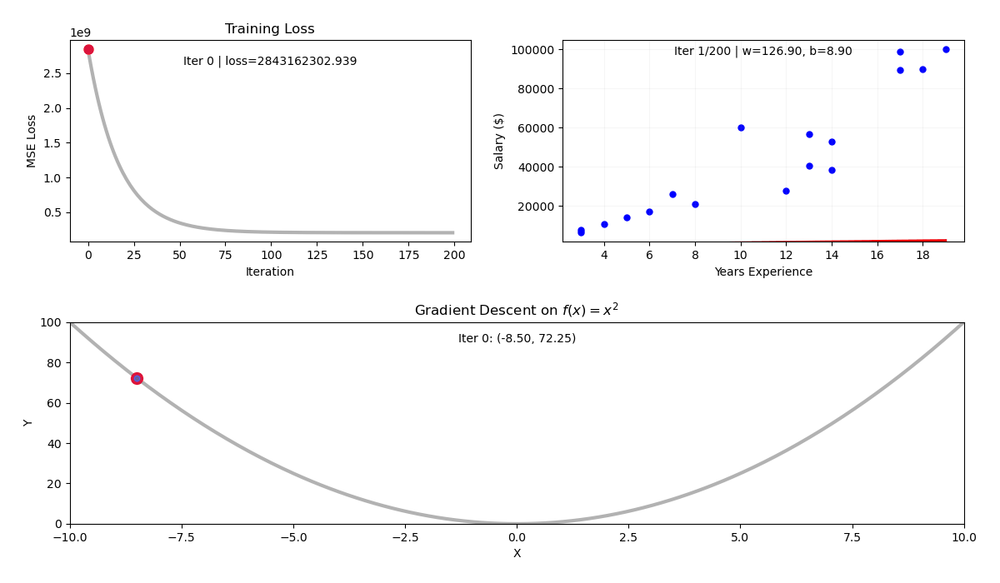

In [7]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML, Image
import matplotlib as mpl

# Increasing limit for embedding animation
mpl.rcParams['animation.embed_limit'] = 100  # in MB

# Preparing data and model history
X = model.X.ravel()
y = model.y.ravel()
hist = model.history    # list of (w, b) over iterations

# Extracting weight and bias values over time
ws = np.array([w for w, b in hist])
bs = np.array([b for w, b in hist])
iters = np.arange(len(hist)) # Iteration index for x-axis

# Defining MSE function to track loss
def mse(w, b):
    return ((w*X + b - y)**2).mean()

# Computing loss at each iteration
losses = np.array([mse(w, b) for w, b in hist])
x_line = np.linspace(X.min(), X.max(), 200) # x-range for regression line


# Gradient descent on f(x) = x^2
f  = lambda x: x**2
df = lambda x: 2*x
x0, lr = -8.5, 0.12 # Starting point and learning rate
xs = [x0]

# Simulating gradient descent on f(x) = x^2
for _ in range(len(hist)-1):
    xs.append(xs[-1] - lr*df(xs[-1]))
xs = np.array(xs)
ys = f(xs)


# Creating figure and axes
fig = plt.figure(figsize=(12,7))

# A. Training loss curve
ax1 = fig.add_subplot(2,2,1)
ax1.plot(iters, losses, color='gray', lw=3, alpha=0.6)
(loss_point,) = ax1.plot([], [], 'o', color='crimson', ms=8)
(loss_path,)  = ax1.plot([], [], '-', color='royalblue', lw=2, alpha=0.8)
ax1.set_xlabel('Iteration'); ax1.set_ylabel('MSE Loss')
ax1.set_title('Training Loss')
txt1 = ax1.text(0.5, 0.88, '', transform=ax1.transAxes, ha='center')

# B. Regression line
ax2 = fig.add_subplot(2,2,2)
ax2.scatter(X, y, s=25, color="blue", label="Data")
(fit_line,) = ax2.plot([], [], lw=2, color="red", label="Regression line")
ax2.set_xlabel("Years Experience"); ax2.set_ylabel("Salary ($)")
ax2.grid(alpha=0.1); 
# ax2.legend(loc='upper left')
txt2 = ax2.text(0.5, 0.93, '', transform=ax2.transAxes, ha='center')

# C. Gradient descent path on parabola
ax3 = fig.add_subplot(2,1,2)     # span full width bottom
x_curve = np.linspace(-10, 10, 400)
ax3.plot(x_curve, f(x_curve), color='gray', lw=3, alpha=0.6)
(point,) = ax3.plot([], [], 'o', color='crimson', ms=10)
(path,)  = ax3.plot([], [], 'o-', color='royalblue', ms=5, lw=2, alpha=0.8)
ax3.set_xlim(-10, 10); ax3.set_ylim(0, 100)
ax3.set_xlabel('X'); ax3.set_ylabel('Y')
ax3.set_title(r'Gradient Descent on $f(x)=x^2$')
txt3 = ax3.text(0.5, 0.9, '', transform=ax3.transAxes, ha='center')

fig.tight_layout(pad=2)


# Animation functions
def init():
    # loss
    loss_point.set_data([], [])
    loss_path.set_data([], [])
    txt1.set_text('')
    # regression
    fit_line.set_data([], [])
    txt2.set_text('')
    # parabola
    point.set_data([], [])
    path.set_data([], [])
    txt3.set_text('')
    return (loss_point, loss_path, fit_line, point, path, txt1, txt2, txt3)

def update(i):
    # A. loss curve
    loss_point.set_data([iters[i]], [losses[i]])
    loss_path.set_data(iters[:i+1], losses[:i+1])
    txt1.set_text(f"Iter {i} | loss={losses[i]:.3f}")

    # B. regression line
    w_i, b_i = ws[i], bs[i]
    fit_line.set_data(x_line, w_i*x_line + b_i)
    txt2.set_text(f"Iter {i+1}/{len(hist)} | w={w_i:.2f}, b={b_i:.2f}")

    # C. parabola GD
    point.set_data([xs[i]], [ys[i]])
    path.set_data(xs[:i+1], ys[:i+1])
    txt3.set_text(f"Iter {i}: ({xs[i]:.2f}, {ys[i]:.2f})")

    return (loss_point, loss_path, fit_line, point, path, txt1, txt2, txt3)

# Creating animation object
ani = FuncAnimation(fig, update, frames=len(hist), init_func=init,
                    interval=100, blit=False, repeat=False)

plt.close(fig) # Prevents duplicate static image

# Inline playback
HTML(ani.to_jshtml())

ani.save(
    "linear_regression.gif",
    writer=PillowWriter(fps=12),   # Controls frame rate
    dpi=100                     # Lower DPI = smaller file size
)

# Showing saved GIF
Image("linear_regression.gif")   

# Logistic Regression

**Logistic Regression** is a type of supervised learning algorithm used for categorical target variables. Unlike linear regression, which can output values across the entire number line, classification tasks require predictions to fall within a specific range—typically between 0 and 1.

For example, in an email classification task where we want to determine if a message is spam or not, linear regression is unsuitable because it produces unbounded outputs. However, classification requires a discrete prediction, such as 0 (not spam) or 1 (spam).

To address this, Logistic Regression applies the sigmoid (or logistic) activation function to the output of a linear equation. This transforms the output into a probability value between 0 and 1.

The modified **hypothesis function** for Logistic Regression becomes:

$$\hat{y} = \sigma(w \cdot x + b) = \frac{1}{1 + e^{-(w \cdot x + b)}}$$


- $\hat{y}$: predicted **probability** between 0 and 1  
- $x$: input feature(s)  
- $w$: weight(s)  
- $b$: bias (intercept)  
- $\sigma(z)$: **sigmoid function** to squash values into range (0, 1)

Interpretation of prediction $\hat{y}$ value is:
- If $\hat{y} \geq 0.5$, predict **class 1**  
- If $\hat{y} < 0.5$, predict **class 0**  

This is how **logistic regression** works as a **binary classifier**. It calculates a probability and applies a threshold (usually 0.5) to decide the final class.


In logistic regression, we cannot use the same cost function as in linear regression (Mean Squared Error) because it becomes **non-convex** when applied to a sigmoid function. Non-convex functions are hard to optimize — they can have multiple local minima, causing gradient descent to fail to converge properly. Instead, we use a Loss Function specifically designed for classification: the **Binary Cross-Entropy Loss (or Log Loss)**, which is convex and works well with the sigmoid function.

**Loss Function (for One Sample).** The Loss Function measures the error for a single training example:
$$L(y, \hat{y}) = - (y \log\hat{y} + (1 - y) \log(1 - \hat{y}))$$
 
- $y^{(i)}$: actual label (0 or 1)
- $\hat{y}^{(i)}$: predicted probability of the model is in (0,1)

**Cost Function (Log Loss - for All Samples).** To train the model on the entire dataset, we use the average loss over all training samples — this is the cost function:

$ J(w, b) = - \frac{1}{m} \sum_{i=1}^{m} \left[ y^{(i)} \log(\hat{y}^{(i)}) + (1 - y^{(i)}) \log(1 - \hat{y}^{(i)}) \right] $

- $m$: number of training examples  
- $y^{(i)}$: actual label (0 or 1) for the $i^{th}$ training example  
- $\hat{y}^{(i)}$: predicted probability  
- $\sigma(z) = \frac{1}{1 + e^{-z}}$: sigmoid function


We use **gradient descent** to minimize the cost function by updating the weights \( w \) and bias \( b \):

$$w := w - \alpha \cdot \frac{\partial J(w, b)}{\partial w}$$
$$b := b - \alpha \cdot \frac{\partial J(w, b)}{\partial b}$$

- $\alpha$: learning rate (step size)

The gradients are computed as follows:

$$\frac{\partial J}{\partial w} = \frac{1}{m} \sum_{i=1}^{m} \left( \hat{y}^{(i)} - y^{(i)} \right) x^{(i)}$$
$$\frac{\partial J}{\partial b} = \frac{1}{m} \sum_{i=1}^{m} \left( \hat{y}^{(i)} - y^{(i)} \right)$$

This process is repeated until the model converges to optimal parameters.

In [8]:
def sigmoid(z):
    return 1 / (1 + np.exp(-z))
    
class Logistic_Regression():
    def __init__(self, no_of_iterations=100, learning_rate=0.001):
        # Initializing hyperparameters
        self.no_of_iterations = no_of_iterations
        self.learning_rate = learning_rate


    def fit(self, X, y):
        # Storing number of samples (m) and features (n)
        self.m, self.n = X.shape
        
        # Storing training data
        self.X = X
        self.y = y
        
        # Initializing weights (w) as zero vector and bias (b) as 0
        self.w = np.zeros(self.n)
        self.b = 0
        self.history = []
        
        # Performing gradient descent for given number of iterations
        for i in range(self.no_of_iterations):
            self.update_weight()
            y_hat = sigmoid(np.dot(self.X, self.w) + self.b)
            cost = - (1 / self.m) * np.sum(y * np.log(y_hat + 1e-8) + (1 - y) * np.log(1 - y_hat + 1e-8))
            self.history.append((self.w.copy(), self.b, cost))
    
    
    def update_weight(self):
        # Computing predictions using the sigmoid function
        y_hat = sigmoid(np.dot(self.X, self.w) + self.b)
        
        # Computing gradients for weights and bias
        dw =  (1/self.m) * np.dot(self.X.T, (y_hat - self.y)) # Gradient weights
        db =  (1/self.m) * np.sum(y_hat - self.y) # Gradient bias

        # Updating weights and bias using the gradients and learning rate
        self.w = self.w - self.learning_rate*dw
        self.b = self.b - self.learning_rate*db

    
    def predict(self, X):
        # Computing predicted probabilities
        y_pred = 1 / (1+np.exp(-(X.dot(self.w) + self.b) ))

        # Converting probabilities to class labels using 0.5 threshold
        y_pred = np.where(y_pred > 0.5, 1, 0)
        return y_pred

In [9]:
diabetes_data = pd.read_csv("diabetes2.csv")
diabetes_data

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [10]:
diabetes_data["Outcome"].value_counts()

Outcome
0    500
1    268
Name: count, dtype: int64

In [11]:
diabetes_data.groupby("Outcome").mean()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
Outcome,,,,,,,,
0,3.298000,109.980000,68.184000,19.664000,68.792000,30.304200,0.429734,31.190000
1,4.865672,141.257463,70.824627,22.164179,100.335821,35.142537,0.550500,37.067164


In [12]:
features = diabetes_data.drop(columns="Outcome", axis=1)
target = diabetes_data["Outcome"]
print(features, target)

     Pregnancies  Glucose  BloodPressure  SkinThickness  Insulin   BMI  \
0              6      148             72             35        0  33.6   
1              1       85             66             29        0  26.6   
2              8      183             64              0        0  23.3   
3              1       89             66             23       94  28.1   
4              0      137             40             35      168  43.1   
..           ...      ...            ...            ...      ...   ...   
763           10      101             76             48      180  32.9   
764            2      122             70             27        0  36.8   
765            5      121             72             23      112  26.2   
766            1      126             60              0        0  30.1   
767            1       93             70             31        0  30.4   

     DiabetesPedigreeFunction  Age  
0                       0.627   50  
1                       0.351   31  


In [13]:
scaler = StandardScaler()

In [14]:
scaler.fit(features)

StandardScaler()

In [15]:
standardized_data = scaler.transform(features)
standardized_data

array([[ 0.63994726,  0.84832379,  0.14964075, ...,  0.20401277,
         0.46849198,  1.4259954 ],
       [-0.84488505, -1.12339636, -0.16054575, ..., -0.68442195,
        -0.36506078, -0.19067191],
       [ 1.23388019,  1.94372388, -0.26394125, ..., -1.10325546,
         0.60439732, -0.10558415],
       ...,
       [ 0.3429808 ,  0.00330087,  0.14964075, ..., -0.73518964,
        -0.68519336, -0.27575966],
       [-0.84488505,  0.1597866 , -0.47073225, ..., -0.24020459,
        -0.37110101,  1.17073215],
       [-0.84488505, -0.8730192 ,  0.04624525, ..., -0.20212881,
        -0.47378505, -0.87137393]])

In the diabetes dataset some features (like Glucose at ~100–200) are on completely different scales than others (like BMI at ~30–40), so we are using StandardScaler to "standardize” them (subtract the mean and divide by the standard deviation) to put them all on a similar 0‑mean, unit‑variance scale. This makes it easier for the model to learn because no single feature will dominate just by virtue of having larger numbers.

In [16]:
features = standardized_data

In [17]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

In [18]:
print(features.shape, X_train.shape, X_test.shape, y_train.shape)

(768, 8) (614, 8) (154, 8) (614,)


In [19]:
classifier = Logistic_Regression(learning_rate=0.01, no_of_iterations=2000)
classifier.fit(X_train, y_train)

In [20]:
X_train_prediction = classifier.predict(X_train)
training_data_accuracy = accuracy_score(y_train, X_train_prediction)
print("Accuracy score of training data: ", training_data_accuracy)

Accuracy score of training data:  0.7654723127035831


In [21]:
X_test_prediction = classifier.predict(X_test)
testing_data_accuracy = accuracy_score(y_test, X_test_prediction)
print("Accuracy score of test data: ", testing_data_accuracy)

Accuracy score of test data:  0.7532467532467533


In [22]:
# Example new patient data (Pregnancies, Glucose, BloodPressure, SkinThickness, Insulin, BMI, DiabetesPedigreeFunction, Age)
input_data = (5, 166, 72, 19, 175, 25.8, 0.587, 51)

# Converting to numpy array
input_data_as_numpy_array = np.asarray(input_data)

# Reshaping because we are predicting for ONE instance (scikit-learn expects 2D)
input_data_reshaped = input_data_as_numpy_array.reshape(1, -1)

# Standardizing using the *already-fitted* scaler from training
std_data = scaler.transform(input_data_reshaped)
print("Standardized input:", std_data)

# Making prediction
prediction = classifier.predict(std_data)
print("Raw prediction:", prediction)

# Interpreting the result
if prediction[0] == 0:
    print("The person is not diabetic")
else:
    print("The person is diabetic")

Standardized input: [[ 0.3429808   1.41167241  0.14964075 -0.09637905  0.82661621 -0.78595734
   0.34768723  1.51108316]]
Raw prediction: [1]
The person is diabetic


C:\Users\Laylo Karimova\.conda\envs\ML_projects\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


For our plot below we are choosing only two features from our diabetes dataset. Using 2 features keeps the model realistic (it still fits a 2‑D input) while letting us visualize the effect of changing one feature on the predicted probability. With 8 features, we can’t draw a meaningful picture—so for educational purposes we slice to a couple of features to make the learning process visible.

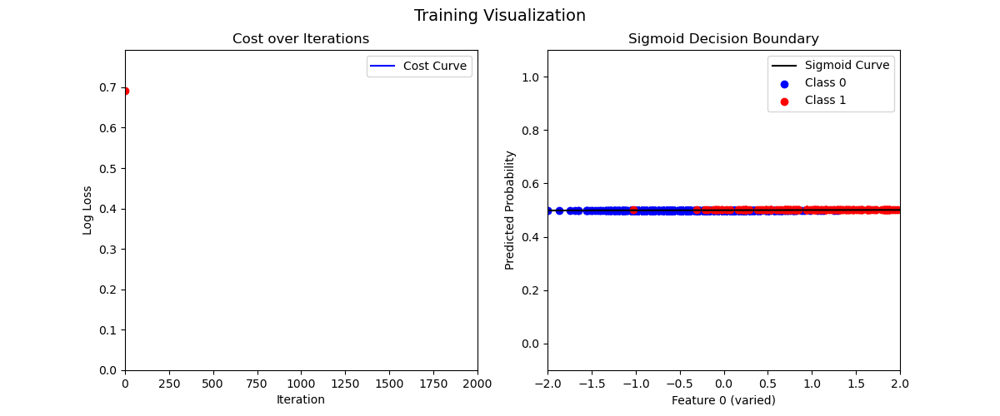

In [23]:
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import Image, display

# Choosing two features (by column indices) from our original training matrix.
feature_1 = 1  # 'Plasma glucose concentration'
feature_2 = 5  # 'BMI'

X_selected = X_train[:, [1, 5]] 
# Fit your custom logistic-regression classifier on the two-feature data.
classifier.fit(X_selected, y_train)


# Sigmoid function
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

# Animation function
def animate_logistic_training(model, X_train, X_plot_range=(-2, 2), filename="logistic_regression.gif"):
    """
    Animate two things as training progresses:
      1) Cost vs. iteration (left subplot) using the model's saved history.
      2) Sigmoid probability curve (right subplot) as we vary ONLY the first feature
         and keep all other features fixed at their mean.
    Assumes model.history is a list of tuples: (w, b, cost) per iteration.
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle("Training Visualization", fontsize=14)

    # Left: cost curve setup
    ax1.set_title("Cost over Iterations")
    ax1.set_xlabel("Iteration")
    ax1.set_ylabel("Log Loss")
    ax1.set_xlim(0, len(model.history))
    ax1.set_ylim(0, max(c for _, _, c in model.history) + 0.1)
    cost_line, = ax1.plot([], [], 'b-', label="Cost Curve")
    cost_point, = ax1.plot([], [], 'ro')
    ax1.legend()

    # Right: sigmoid vs. first feature (others fixed at mean)
    ax2.set_title("Sigmoid Decision Boundary")
    ax2.set_xlabel("Feature 0 (varied)")
    ax2.set_ylabel("Predicted Probability")
    ax2.set_xlim(X_plot_range)
    ax2.set_ylim(-0.1, 1.1)
    boundary_line, = ax2.plot([], [], 'k-')

    def animate(i):
        w, b, cost = model.history[i]

        # Cost plot update
        costs = [c for _, _, c in model.history[:i + 1]]
        cost_line.set_data(range(i + 1), costs)
        cost_point.set_data([i], [cost])

        # Decision boundary update
        ax2.clear()
        ax2.set_xlim(X_plot_range)
        ax2.set_ylim(-0.1, 1.1)
        ax2.set_title("Sigmoid Decision Boundary")
        ax2.set_xlabel("Feature 0 (varied)")
        ax2.set_ylabel("Predicted Probability")

        # Varying only the first feature, fix others at mean
        x_vals = np.linspace(X_plot_range[0], X_plot_range[1], 200).reshape(-1, 1)
        x_dummy = np.tile(np.mean(X_train, axis=0), (200, 1))
        x_dummy[:, 0] = x_vals[:, 0]  # vary only first feature

        y_vals = sigmoid(np.dot(x_dummy, w) + b)
        ax2.plot(x_vals, y_vals, 'k-', label='Sigmoid Curve')

        # Also plotting the actual predictions (first feature vs. prob)
        preds = sigmoid(np.dot(X_train, w) + b)
        class_0 = preds < 0.5
        class_1 = preds >= 0.5
        ax2.scatter(X_train[class_0, 0], preds[class_0], color='blue', label='Class 0')
        ax2.scatter(X_train[class_1, 0], preds[class_1], color='red', label='Class 1')
        ax2.legend()

        return cost_line, cost_point, boundary_line
    
    # Creating the animation: one frame per saved training step
    ani = FuncAnimation(fig, animate, frames=len(model.history), interval=100, blit=False)
    # Hiding the live figure and save as a GIF, then display it in the notebook
    plt.close(fig)
    ani.save(filename, writer=PillowWriter(fps=10))
    display(Image(filename))

# Run the animation on the two-feature training data
# “I trained on two features here to visualize the boundary in 2‑D; the full model can be trained on all features.”
animate_logistic_training(classifier, X_selected)

# Support Vector Machine Classifier

**Support Vector Machine (SVM)** is a **supervised learning algorithm** used for classification (and regression). In this implementation, we are focusing on creating a **linear SVM classifier** with a **soft margin**, optimized using **stochastic gradient descent**.

### Hyperplane (Decision Boundary)

The decision boundary (also known as the hyperplane) is the line (or plane in higher dimensions) that separates the data points into two classes. The goal of SVM is to find the best hyperplane that divides the classes with the maximum margin. 

- **Hyperplane Equation**:  
  $ w^\top x + b = 0 $

  - $ w $: weight vector, which is learned during training
  - $ x $: input feature vector
  - $ b $: bias term, also learned during training

- **Classification rule**:  
  For any data point $ x $, classify it as:
  $
  \hat{y} = 
  \begin{cases}
    +1 & \text{if } w^\top x + b \geq 0 \\
    -1 & \text{otherwise}
  \end{cases}
  $

### Margin

The margin is the distance between the hyperplane and the closest data points from each class (these are the **support vectors**). The objective is to maximize this margin because a larger margin generally leads to better generalization and more robust classification.

- **Margin Formula**:  
  $
  \text{Margin} = \frac{2}{\|w\|}
  $
  
  The larger the margin, the better the classifier. Maximizing the margin is equivalent to minimizing \( \|w\|^2 \), which is the goal of the SVM.

### Support Vectors

Support vectors are the data points that lie closest to the hyperplane. These points are crucial because they directly influence the position of the decision boundary. If we remove all other data points, the hyperplane will still stay the same, as it depends only on the support vectors.

### Soft Margin

If data is perfectly linearly separable we use **Hard margin**, it does not allow misclassification. Good when data is perfectly clean. But real-world data often overlaps or has noise.
However, in the real world, data often isn't perfectly separable, so we use a **soft margin** approach in our example, which allows for some misclassification. The soft margin approach adds flexibility to the model by allowing a few points to violate the margin constraint.

- **Soft Margin (Objective Function)**:
  $
  \min_{w, b, \xi} \frac{1}{2} \|w\|^2 + C \sum_{i=1}^n \xi_i
  $
  
  - $ \xi_i $ are the slack variables that allow for misclassification.
  - $ C $ is the regularization parameter that trades off the width of the margin and the amount of allowed misclassification.
  - Larger $ C $ forces fewer misclassifications but with a smaller margin (risk of overfitting).
  - Smaller $ C $ allows a wider margin but with more misclassifications (stronger regularization).

### SVM in Our Implementation

In our code, we implemented the following:

1. **Training Phase**:  
   The model is trained by using the **stochastic gradient descent** (SGD) algorithm to minimize the objective function (hinge loss with regularization). The weight vector \( w \) and bias \( b \) are updated iteratively for each data point.

   The weight update rule is:
   $
   w = w - \alpha \frac{\partial L}{\partial w}, \quad b = b - \alpha \frac{\partial L}{\partial b}
   $
   
   Where:
   - $ \alpha $ is the learning rate.
   - The gradients are computed based on the current predictions and the actual labels, adjusting the weights to minimize the hinge loss.

2. **Prediction Phase**:  
   After the model is trained, it can predict the class of new data points by evaluating whether they fall on the positive or negative side of the decision boundary, using the equation:
   $
   f(x) = w^\top x + b
   $
   
   If $ f(x) \geq 0 $, predict class \( +1 \); otherwise, predict class \( -1 \).

### Kernel Trick (Not Implemented in the Code)

In this implementation, we are using a **linear kernel**, which works well when the data is linearly separable. However, if the data is not linearly separable, we could extend the model to use the **kernel trick**, which maps the data into a higher-dimensional space where it becomes separable. This trick is useful for non-linear decision boundaries.

- **Common Kernels**:
  - **Linear Kernel**: $ K(x, z) = x^\top z $
  - **Polynomial Kernel**: $ K(x, z) = (x^\top z + r)^d $
  - **RBF (Gaussian) Kernel**: $ K(x, z) = \exp(-\gamma \|x - z\|^2) $
  - **Sigmoid Kernel**: $ K(x, z) = \tanh(\gamma x^\top z + r) $

In our current implementation, we are not using the kernel trick, but it could be added for non-linear classification by modifying the **predict** method to apply a kernel transformation.

### Practical Implementation Notes

- **Scaling**: SVMs are sensitive to the scale of the input features, so we recommend scaling the features to have zero mean and unit variance before training.
- **Learning Rate**: The learning rate in gradient descent controls the speed at which the weights are updated. A high learning rate may cause the algorithm to converge too quickly, while a low learning rate may slow down convergence.


In [24]:
class SVM_classifier():
    def __init__(self, no_of_iterations=1000, learning_rate=0.01, lambda_parameter=0.01):
        self.no_of_iterations = no_of_iterations
        self.learning_rate = learning_rate
        self.lambda_parameter = lambda_parameter

    def fit(self, X, y):
        self.m, self.n = X.shape

        self.X = X
        self.y = y
        
        self.w = np.zeros(self.n)
        self.b = 0
        
        
        for i in range(self.no_of_iterations):
            self.update_weight()
    
    
    def update_weight(self):
        # assumes positive class is >0 and negative is <=0
        y_label = np.where(self.y <= 0, -1, 1)
    
        for index, x_i in enumerate(self.X):
            condition = y_label[index] * (np.dot(x_i, self.w) - self.b) >= 1
            
            if (condition == True): 
                # Correctly classified with margin >= 1:
                # gradient comes only from the L2 penalty (keep margin wide).
                dw =  2 * self.lambda_parameter * self.w
                db =  0
            else:
                # Misclassified or within margin:
                # gradient = regularization part - data part (hinge loss subgradient)
                # For linear SVM with hinge loss:
                #   ∂L/∂w = 2λw - x_i * y_i
                #   ∂L/∂b = + y_i    (note sign matches your "- b" decision function)
                dw =  2 * self.lambda_parameter * self.w - np.dot(x_i, y_label[index])
                db =  y_label[index]               

        # Parameter update (SGD step)
        self.w = self.w - self.learning_rate * dw
        self.b = self.b - self.learning_rate * db
    
    
    def predict(self, X):
        output = np.dot(X, self.w) - self.b
        predicted_labels = np.sign(output)
        # Mapping to {0,1}: treat -1 as class 0, everything else as class 1
        y_hat = np.where(predicted_labels <= -1, 0, 1)
        return y_hat

In [25]:
diabetes_data = pd.read_csv("diabetes2.csv")
diabetes_data.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [26]:
features = diabetes_data.drop(columns="Outcome", axis=1)
target = diabetes_data["Outcome"]
# print(features, target)

In [27]:
scaler = StandardScaler()
scaler.fit(features)

StandardScaler()

In [28]:
standardized_data = scaler.transform(features)
features = standardized_data

In [29]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

In [30]:
print(features.shape, X_train.shape, X_test.shape, y_train.shape)

(768, 8) (614, 8) (154, 8) (614,)


In [31]:
classifier = SVM_classifier(no_of_iterations=1000, learning_rate=0.001, lambda_parameter=0.01)

In [32]:
classifier.fit(X_train, y_train)

In [33]:
X_train_prediction = classifier.predict(X_train)
training_data_accuracy = accuracy_score(y_train, X_train_prediction)
print("Accuracy score of training data: ", training_data_accuracy)

Accuracy score of training data:  0.6628664495114006


In [34]:
X_test_prediction = classifier.predict(X_test)
test_data_accuracy = accuracy_score(y_test, X_test_prediction)
print("Accuracy score of test data: ", testing_data_accuracy)

Accuracy score of test data:  0.7532467532467533


In [35]:
# Example input data tuple (replace with real values in correct feature order)
input_data = (5, 166, 72, 19, 175, 25.8, 0.587, 51)

# 1. Converting to numpy array
input_data_as_numpy_array = np.asarray(input_data)

# 2. Reshaping for a single sample (scikit-learn expects 2D: (n_samples, n_features))
input_data_reshaped = input_data_as_numpy_array.reshape(1, -1)

# 3. Standardizing using the previously-fitted scaler
std_data = scaler.transform(input_data_reshaped)
print(std_data)          # standardized feature values

# 4. Predicting
prediction = classifier.predict(std_data)
print(prediction)        # e.g. [0] or [1]

# 5. Interpreting result (assuming 0 = not diabetic, 1 = diabetic)
if prediction[0] == 0:
    print('The person is not diabetic')
else:
    print('The Person is diabetic')


[[ 0.3429808   1.41167241  0.14964075 -0.09637905  0.82661621 -0.78595734
   0.34768723  1.51108316]]
[1]
The Person is diabetic


C:\Users\Laylo Karimova\.conda\envs\ML_projects\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


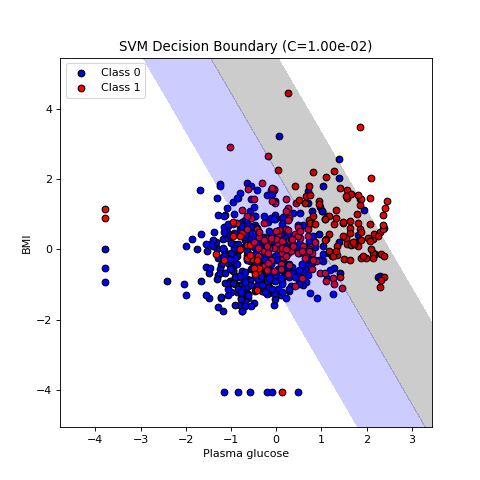

In [36]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import Image, display

def animate_svm_over_C(X, y, C_vals, filename="svm_C.gif"):
    # Building a mesh over the 2D feature space
    x0 = np.linspace(X[:,0].min()-1, X[:,0].max()+1, 200)
    x1 = np.linspace(X[:,1].min()-1, X[:,1].max()+1, 200)
    XX0, XX1 = np.meshgrid(x0, x1)
    grid = np.c_[XX0.ravel(), XX1.ravel()]

    # Creating the figure and basic axes formatting
    fig, ax = plt.subplots(figsize=(6,6))

    # Defining the frame update function
    def update(i):
        C = C_vals[i] # picking the C for this frame
        
        ax.clear() # clearing previous frame drawings
        ax.set_xlabel("Plasma glucose")
        ax.set_ylabel("BMI")
        ax.set_title("SVM Decision Boundary (C={:.2e})".format(C))
        
        # scatter training points
        ax.scatter(X[y==0,0], X[y==0,1], c='blue',  edgecolor='k', label='Class 0')
        ax.scatter(X[y==1,0], X[y==1,1], c='red',   edgecolor='k', label='Class 1')
        
        # Fitting a *linear* SVM with the current 
        svm = SVC(C=C, kernel='linear').fit(X, y)
        
        # Evaluating the decision function f(x) on the mesh grid
        Z = svm.decision_function(grid).reshape(XX0.shape)
        
        # Filled contour:
        #   values < 0  → one side of the hyperplane
        #   values = 0  → the decision boundary (hyperplane)
        #   values > 0  → the other side
        ax.contourf(
            XX0, XX1, Z,
            levels=[-1, 0, 1],
            alpha=0.2,
            colors=['blue','none','red']
        )
        ax.legend(loc='upper left')
        return []

    # Building the animation and save as GIF
    ani = FuncAnimation(
        fig, update, frames=len(C_vals),
        interval=300, blit=False, repeat=True
    )
    plt.close(fig)
    ani.save(filename, writer=PillowWriter(fps=5), dpi=80)
    display(Image(filename))


#   Decision boundaries live in the same dimensionality as the input.
#   With 8 features, we cannot *see* the boundary; for teaching/intuition
#   we select two (e.g., Plasma glucose and BMI) so we can plot in 2D.
# 1 = Plasma glucose, 5 = BMI
feat0, feat1 = 1, 5
X2 = X_train[:, [feat0, feat1]]
animate_svm_over_C(X2, y_train, C_vals=np.logspace(-2, 2, 20))

# K-Nearest Neighbors

**K-Nearest Neighbors** is a powerful yet simple classification algorithm. It makes predictions by comparing new data points to its k-nearest data points and assigning a class based on the majority class of its neighbors. The algorithm's performance can be sensitive to the value of **k**. When **k** is small, the model is sensitive to noise and is prone to overfitting. When **k** is large, it can lead to underfitting, especially if there is class imbalance. When the number of classes is 2, **k** should be an odd number to prevent any 'tied votes' when making predictions. The value of **k** should be larger than the number of classes for similar reasons.

### Metrics

The meaning of 'nearest' depends on what metric you use. Usually, **Euclidean distance** is used, but others like **Manhattan** and **Minkowski** distance can be used as well.

An example data point can be represented as:
$ \langle x_1, x_2, \ldots, x_n \rangle$

Distance between two points $ \mathbf{x}_a $ and $ \mathbf{x}_b $ is given by:
- **Euclidean**
 $$
 d_{\text{euclid}}(\mathbf{x}_a, \mathbf{x}_b) 
 = \sqrt{\sum_{j=1}^{n} (x_{a_j} - x_{b_j})^2 }
 $$
- **Manhattan**
  
  $$
  d_{\text{manhattan}}(\mathbf{x}_a, \mathbf{x}_b)
  = \sum_{j=1}^{N}\lvert x_{a_j} - x_{b_j}\rvert
  $$




### Pseudocode:
1. **Store all training examples**: 
   - The first step in the k-NN algorithm is to store all the training data in memory. Each data point in the training set is a vector of features (input values) and a corresponding label (class).
   - For example, in a classification problem, each data point might be represented as a vector of features like $ \langle x_1, x_2, \ldots, x_n \rangle $, and a label ('cat' or 'dog').

2. **Repeat steps 3, 4, and 5 for each test example**:
   - This step means that for each new unseen (test) data point, we will apply the following steps to predict its label.

3. **Find the k nearest training examples to the current test example**:
   - Calculating the distance between the test example and every point in the training set using a distance metric (commonly Euclidean distance, but others like Manhattan or Minkowski can also be used).
   - For each training example $ \mathbf{x}_i $ and the test example $ \mathbf{x}_t $, we need to compute the distance:
   
     $
     d(\mathbf{x}_t, \mathbf{x}_i) = \sqrt{\sum_{j=1}^{n} (x_{t_j} - x_{i_j})^2 }
     $
     
   - Once distances are computed, we should sort the distances in ascending order and select the **k** smallest distances. These represent the **k nearest neighbors** to the test example.

4. **y_pred for the current test example = most common class among k-nearest training instances**:
   - After identifying the **k nearest neighbors**, we now determine the majority class among those k points.
   - The class with the most occurrences among the **k nearest neighbors** becomes the predicted class for the test example.
   - This is done by checking the class labels of the k nearest points and assigning the test example to the class that appears most frequently. If there's a tie (two classes have the same number of votes), we can either:
     - Pick the class of the nearest neighbor.
     - Choose randomly between the tied classes (though this is rare in practice).

5. **Go to step 2**:
   - After predicting the class of one test example, the algorithm moves on to the next test example and repeats the process until all test examples have been classified.
   
   
### Practical notes

- **Choice of \(k\).** Small \(k\) → noisy/overfitting; large \(k\) → over‑smoothing/underfitting. Pick \(k\) via cross‑validation.  
- **Feature scaling.** Distances are scale‑sensitive; standardize features (z‑score) for stability.  
- **Complexity.** Naive prediction scans all training points (distance to each) and sorts to get the top‑k.

In [37]:
import statistics
class KNN_Classifier():
    def __init__(self, distance_metric):
        self.distance_metric = distance_metric


    def get_distance_metric(self, training_data_point, test_data_point):
        """
        Computing the distance between one training row and the test point.
        Uses only the first N entries (features). The training label is at index -1 and is ignored.
        """
        if (self.distance_metric == "euclidean"):
            # accumulating squared differences over all features
            dist = 0 
            
            for i in range(len(training_data_point) -1):
                dist = dist + (training_data_point[i] - test_data_point[i])**2
                
            euclidean_dist = np.sqrt(dist)
            return euclidean_dist
        
        elif (self.distance_metric == 'manhattan'):
            # accumulating absolute differences over all features
            dist = 0
            
            for i in range(len(training_data_point) -1):
                dist = dist + abs(training_data_point[i] - test_data_point[i])
            
            manhattan_dist = dist
            return manhattan_dist
    
    def nearest_neighbors(self, X_train, test_data, k):
        distance_list = []
        
        # Computing distances to every training row
        for training_data in X_train:
            distance = self.get_distance_metric(training_data, test_data)
            distance_list.append((training_data, distance))
        
        # Sorting ascending by distance (second element of the tuple)
        distance_list.sort(key=lambda x:x[1])
        
        neighbors_list = []

        for j in range(k):
            neighbors_list.append(distance_list[j][0])
        
        return neighbors_list
        
    
    def predict(self, X_train, test_data, k):
        neighbors = self.nearest_neighbors(X_train, test_data, k)
        
        # Collecting labels from the k neighbor rows (label is the last column)
        label = []
        for data in neighbors:
            label.append(data[-1])
            
        predicted_class = statistics.mode(label)
        return predicted_class

In [38]:
diabetes_data = pd.read_csv("diabetes2.csv")

X = diabetes_data.drop(columns="Outcome", axis=1)
Y = diabetes_data["Outcome"]

X = X.to_numpy()
Y = Y.to_numpy()

In [39]:
print(X)
print(Y)

[[  6.    148.     72.    ...  33.6     0.627  50.   ]
 [  1.     85.     66.    ...  26.6     0.351  31.   ]
 [  8.    183.     64.    ...  23.3     0.672  32.   ]
 ...
 [  5.    121.     72.    ...  26.2     0.245  30.   ]
 [  1.    126.     60.    ...  30.1     0.349  47.   ]
 [  1.     93.     70.    ...  30.4     0.315  23.   ]]
[1 0 1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0
 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1 0
 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1
 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 0 0
 1 1 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 1
 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0
 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 1 0 0
 1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 0 0 1 0

In [40]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=2)

print(X.shape, X_train.shape, X_test.shape)
print(X_train)

(768, 8) (614, 8) (154, 8)
[[0.00e+00 1.19e+02 0.00e+00 ... 3.24e+01 1.41e-01 2.40e+01]
 [6.00e+00 1.05e+02 7.00e+01 ... 3.08e+01 1.22e-01 3.70e+01]
 [1.00e+00 1.89e+02 6.00e+01 ... 3.01e+01 3.98e-01 5.90e+01]
 ...
 [1.10e+01 8.50e+01 7.40e+01 ... 3.01e+01 3.00e-01 3.50e+01]
 [4.00e+00 1.12e+02 7.80e+01 ... 3.94e+01 2.36e-01 3.80e+01]
 [0.00e+00 8.60e+01 6.80e+01 ... 3.58e+01 2.38e-01 2.50e+01]]


In [41]:
X_train = np.insert(X_train, 8, y_train, axis=1)

print(X_train)

[[0.00e+00 1.19e+02 0.00e+00 ... 1.41e-01 2.40e+01 1.00e+00]
 [6.00e+00 1.05e+02 7.00e+01 ... 1.22e-01 3.70e+01 0.00e+00]
 [1.00e+00 1.89e+02 6.00e+01 ... 3.98e-01 5.90e+01 1.00e+00]
 ...
 [1.10e+01 8.50e+01 7.40e+01 ... 3.00e-01 3.50e+01 0.00e+00]
 [4.00e+00 1.12e+02 7.80e+01 ... 2.36e-01 3.80e+01 0.00e+00]
 [0.00e+00 8.60e+01 6.80e+01 ... 2.38e-01 2.50e+01 0.00e+00]]


In [42]:
X_train.shape

(614, 9)

In [43]:
classifier = KNN_Classifier(distance_metric = "euclidean")
prediction = classifier.predict(X_train, X_test[0], k=5)

In [44]:
# classifier = KNN_Classifier(distance_metric = "manhattan")

In [45]:
print(X_test[0])
print(y_test[0])
print(prediction)

[  3.    106.     72.      0.      0.     25.8     0.207  27.   ]
0
0.0


In [46]:
X_test_size = X_test.shape[0]

In [47]:
# Predicting the labels for test data
y_pred = []
for i in range(X_test_size):
    prediction = classifier.predict(X_train, X_test[i], k=5)
    y_pred.append(prediction)

print(y_pred)

[np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(1.0), np.float64(1.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.

In [48]:
# True labels
y_true = y_test

# Model Evaluation
accuracy = accuracy_score(y_true, y_pred)
print(accuracy * 100)  # accuracy score in %

72.72727272727273


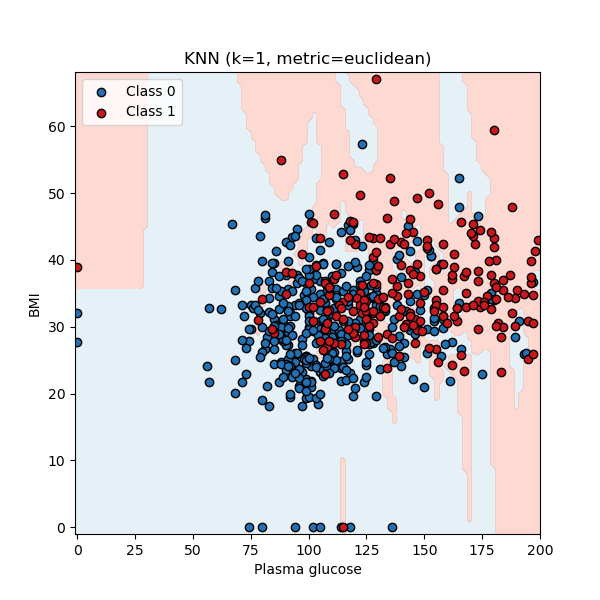

In [49]:
import numpy as np
import statistics
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import Image, display


# animation routine
def animate_knn_over_k(
    X, y,  
    ks=(1,3,5,7,9), # Sequence of k‑values to animate
    distance_metric="euclidean",
    grid_res=140, # Number of grid points per axis for decision surface
    filename="knn.gif"  # Output GIF filename
):
    X = np.asarray(X)
    y = np.asarray(y)
    
    # Appending labels as a third column so our scratch KNN can consume [x1, x2, y]
    Xy = np.c_[X2, y]

    # Building a regular grid over the 2‑D feature space
    x0 = np.linspace(X2[:,0].min()-1, X2[:,0].max()+1, grid_res)
    x1 = np.linspace(X2[:,1].min()-1, X2[:,1].max()+1, grid_res)
    XX0, XX1 = np.meshgrid(x0, x1)
    grid_pts = np.c_[XX0.ravel(), XX1.ravel()]

    fig, ax = plt.subplots(figsize=(6,6))
    ax.set_xlabel("Plasma glucose")
    ax.set_ylabel("BMI")

    # The update() function for each frame
    def update(frame):
        k = ks[frame]
        clf = KNN_Classifier(distance_metric=distance_metric)

        # Classifying every grid point with our scratch KNN
        Z = [clf.predict(Xy, pt, k) for pt in grid_pts]
        Z = np.array(Z).reshape(XX0.shape)

        ax.clear()
        ax.set_title(f"KNN (k={k}, metric={distance_metric})")
        ax.set_xlabel("Plasma glucose")
        ax.set_ylabel("BMI")

        # Plotting decision regions (0 in blueish, 1 in reddish)
        ax.contourf(XX0, XX1, Z, levels=[-0.5,0.5,1.5],
                    colors=["#9ecae1","#fb6a4a"], alpha=0.25)

        # Plotting training points
        ax.scatter(X2[y==0,0], X2[y==0,1],
                   c="#2171b5", edgecolor="k", label="Class 0")
        ax.scatter(X2[y==1,0], X2[y==1,1],
                   c="#cb181d", edgecolor="k", label="Class 1")
        ax.legend(loc="upper left")

    ani = FuncAnimation(fig, update,
                        frames=len(ks), interval=600,
                        blit=False, repeat=True)

    plt.close(fig)
    ani.save(filename, writer=PillowWriter(fps=2), dpi=100)
    display(Image(filename))


X2 = X_train[:, [1,5]]
animate_knn_over_k(X2, y_train,      
                   ks=(1,3,5,7,9),
                   distance_metric="euclidean",
                   grid_res=100,
                   filename="knn.gif")